<a href="https://colab.research.google.com/github/atroitskaia/CollegeBasketballSalaryPrediction/blob/main/salary__prediction_models_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### This notebook contains additional models with engeneered features and additional optimizations
1. XG Boost with new engeneered features
2.

In [63]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [64]:
import os
from google.colab import data_table

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline
from datetime import datetime

import scipy
import scipy.stats as stats
from scipy.stats import chi2_contingency
import statsmodels.api as sm


from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.inspection import permutation_importance
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.inspection import PartialDependenceDisplay, partial_dependence # import from sklearn.inspection
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


from xgboost import XGBRegressor
import xgboost as xgb

import seaborn as sns

import keras
from keras import layers



# from vega_datasets import data


In [65]:
data_table.enable_dataframe_formatter()

data_table.DataTable.max_columns = 300  # Set the maximum number of columns to display

In [66]:
# !pip install xgboost

In [ ]:
# !pip install statsmodels
#!pip install --upgrade scikit-learn


In [102]:
data = pd.read_csv('/content/drive/MyDrive/BrainStation/BrainStation Projects/BS-Capstone-Project/datasets/data/backetball_cleaned_09_24_24.csv')

In [103]:
data.describe()

,Unnamed: 0,Rk,PTS,Pick,Draft Year,G,GS,MP,FG,FGA,...,Draft College_Yale,Pos_C,Pos_F,Pos_G,From_Year,To_Year,Total_Years_Played,Round_1,Round_2,Year 1
count,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,...,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,594.000000,5.940000e+02
mean,296.500000,339.304714,899.109428,28.663300,2016.400673,70.942761,56.296296,1996.267677,317.915825,667.021886,...,0.001684,0.069024,0.436027,0.494949,2014.161616,2015.393939,2.232323,0.542088,0.457912,1.999566e+06
std,171.617307,192.359424,494.777218,16.769676,4.049575,37.032460,31.475032,1065.574804,172.761129,370.493556,...,0.041030,0.253708,0.496309,0.500396,4.070311,4.046487,1.183030,0.498645,0.498645,1.851797e+06
min,0.000000,1.000000,59.000000,1.000000,2010.000000,3.000000,0.000000,69.000000,20.000000,26.000000,...,0.000000,0.000000,0.000000,0.000000,2009.000000,2009.000000,1.000000,0.000000,0.000000,7.500000e+04
25%,148.250000,174.250000,502.250000,14.000000,2013.000000,36.000000,33.000000,1090.750000,178.250000,373.000000,...,0.000000,0.000000,0.000000,0.000000,2010.000000,2012.000000,1.000000,0.000000,0.000000,6.737500e+05
50%,296.500000,340.500000,825.500000,28.000000,2017.000000,66.000000,53.000000,1890.500000,295.500000,604.500000,...,0.000000,0.000000,0.000000,0.000000,2014.000000,2016.000000,2.000000,1.000000,0.000000,1.378242e+06
75%,444.750000,503.750000,1224.750000,42.000000,2020.000000,100.750000,75.000000,2752.000000,432.750000,913.750000,...,0.000000,0.000000,1.000000,1.000000,2018.000000,2019.000000,3.000000,1.000000,1.000000,2.582160e+06
max,593.000000,674.000000,3150.000000,60.000000,2023.000000,153.000000,145.000000,5309.000000,1141.000000,2075.000000,...,1.000000,1.000000,1.000000,1.000000,2022.000000,2022.000000,5.000000,1.000000,1.000000,1.105512e+07


In [104]:
data

,Unnamed: 0,Rk,PTS,Pick,Draft Year,G,GS,MP,FG,FGA,...,Draft College_Yale,Pos_C,Pos_F,Pos_G,From_Year,To_Year,Total_Years_Played,Round_1,Round_2,Year 1
0,0,521,487.0,10,2010,29.0,29.0,962.0,154.0,363.0,...,0.0,0.0,1.0,0.0,2009,2009,1,1,0,2238360.0
1,1,275,990.0,15,2011,70.0,69.0,2236.0,377.0,840.0,...,0.0,0.0,1.0,0.0,2009,2010,2,1,0,1731960.0
2,2,426,616.0,1,2010,37.0,37.0,1288.0,202.0,438.0,...,0.0,0.0,0.0,1.0,2009,2009,1,1,0,5144280.0
3,3,657,192.0,1,2011,11.0,8.0,303.0,55.0,104.0,...,0.0,0.0,0.0,1.0,2010,2010,1,1,0,5144280.0
4,4,77,1578.0,6,2012,73.0,72.0,2452.0,465.0,1036.0,...,0.0,0.0,0.0,1.0,2009,2011,3,1,0,3065040.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
589,589,175,1221.0,54,2019,137.0,57.0,2842.0,455.0,968.0,...,0.0,0.0,0.0,1.0,2014,2018,5,0,1,79568.0
590,590,46,1733.0,59,2017,128.0,125.0,3925.0,627.0,1286.0,...,0.0,0.0,1.0,0.0,2013,2016,4,0,1,77250.0
591,591,160,1248.0,58,2018,132.0,94.0,3295.0,532.0,990.0,...,0.0,1.0,0.0,0.0,2014,2017,4,0,1,77250.0
592,592,425,617.0,53,2017,68.0,61.0,1868.0,207.0,451.0,...,0.0,0.0,0.0,1.0,2015,2016,2,0,1,77250.0


In [73]:
# data.drop(columns=['Unnamed: 0', 'Average Salary', 'Log_Average_Salary'], axis=1, inplace=True)

In [105]:
data

,Unnamed: 0,Rk,PTS,Pick,Draft Year,G,GS,MP,FG,FGA,...,Draft College_Yale,Pos_C,Pos_F,Pos_G,From_Year,To_Year,Total_Years_Played,Round_1,Round_2,Year 1
0,0,521,487.0,10,2010,29.0,29.0,962.0,154.0,363.0,...,0.0,0.0,1.0,0.0,2009,2009,1,1,0,2238360.0
1,1,275,990.0,15,2011,70.0,69.0,2236.0,377.0,840.0,...,0.0,0.0,1.0,0.0,2009,2010,2,1,0,1731960.0
2,2,426,616.0,1,2010,37.0,37.0,1288.0,202.0,438.0,...,0.0,0.0,0.0,1.0,2009,2009,1,1,0,5144280.0
3,3,657,192.0,1,2011,11.0,8.0,303.0,55.0,104.0,...,0.0,0.0,0.0,1.0,2010,2010,1,1,0,5144280.0
4,4,77,1578.0,6,2012,73.0,72.0,2452.0,465.0,1036.0,...,0.0,0.0,0.0,1.0,2009,2011,3,1,0,3065040.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
589,589,175,1221.0,54,2019,137.0,57.0,2842.0,455.0,968.0,...,0.0,0.0,0.0,1.0,2014,2018,5,0,1,79568.0
590,590,46,1733.0,59,2017,128.0,125.0,3925.0,627.0,1286.0,...,0.0,0.0,1.0,0.0,2013,2016,4,0,1,77250.0
591,591,160,1248.0,58,2018,132.0,94.0,3295.0,532.0,990.0,...,0.0,1.0,0.0,0.0,2014,2017,4,0,1,77250.0
592,592,425,617.0,53,2017,68.0,61.0,1868.0,207.0,451.0,...,0.0,0.0,0.0,1.0,2015,2016,2,0,1,77250.0


#### Feature Engineering
* Efficiency metrics
* Shooting efficiency
* College Experience
* College Experience Binning
* Physical Attributes
* Draft Position Binning
* Performance Binning
* Combine Shooting Percentages

per-minute statistics for points, assists, and rebounds.

Shooting Efficiency: Calculated true shooting percentage.

Experience: Derived years played in the NBA.

Physical Attributes: Calculated BMI and wingspan-to-height ratio.
Binning:
Draft position binned into categories.
Performance metrics (points, assists, rebounds) binned into quintiles.
Advanced stats (PER, Win Shares) binned into quintiles.
Overall Shooting Percentage: Combined FG%, 3P%, and FT%.
Salary Transformation: Applied log transformation to salary data.
**bold text**

In [106]:
def engineered_features(df):
  # Efficiency metrics
  df['Points_per_Minute'] = df['PTS'] / df['MP']
  df['Assists_per_Minute'] = df['AST'] / df['MP']
  df['Rebounds_per_Minute'] = df['TRB'] / df['MP']

  # Shooting efficiency
  #Field Goals Attempted (FGA) and (FTA)
  df['True_Shooting_Pct'] = df['PTS'] / (2 * (df['FGA'] + 0.44 * df['FTA']))

  # College experience
  df['Years_in_College'] = df['Total_Years_Played']

  # College experience binning
  # Devided into quantiles
  df['College_Experience_Bin'] = pd.cut(df['Years_in_College'],
                                          bins=[0, 1, 2, 3, 4, float('inf')],
                                          labels=['Freshman', 'Sophomore', 'Junior', 'Senior', 'Graduate'])
  # Physical attributes
  df['BMI'] = df['Weight (lbs)'] / ((df['Height w/shoes'] / 39.37) ** 2)
  df['Wingspan_to_Height_Ratio'] = df['Wingspan'] / df['Height w/shoes']

  # Draft position binning
  df['Draft_Position_Bin'] = pd.cut(df['Pick'], bins=[0, 5, 10, 20, 30, 60],
                                      labels=['Top 5', '6-10', '11-20', '21-30', '31+'])

  # Performance binning
  # TRB total rebounds
  df['PTS_Bin'] = pd.qcut(df['PTS'], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])
  df['AST_Bin'] = pd.qcut(df['AST'], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])
  df['TRB_Bin'] = pd.qcut(df['TRB'], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])

  # Combined shooting percentages
  df['Overall_Shooting_Pct'] = (df['FG%'] + df['3P%'] + df['FT%']) / 3

  # Advanced stats binning
  df['PER_Bin'] = pd.qcut(df['PER'], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])
  df['WS_Bin'] = pd.qcut(df['WS'], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])

  # Log Transform Salary
  df['Log_Salary'] = np.log1p(df['Average Salary'])
  # df['Log_Salary_Year1'] = np.log1p(df['Year 1'])



  # Standardize numerical features
  scaler = StandardScaler()
  numerical_features = ['Points_per_Minute', 'Assists_per_Minute', 'Rebounds_per_Minute',
                        'True_Shooting_Pct', 'BMI', 'Wingspan_to_Height_Ratio',
                        'Overall_Shooting_Pct', 'Years_in_College' ]
  df[numerical_features] = scaler.fit_transform(df[numerical_features])
  return df

In [107]:
df_engineered = engineered_features(data)



In [108]:
# df_engineered.drop(columns=['Unnamed: 0', 'Average Salary'], axis=1, inplace=True)
df_engineered.drop(columns=['Unnamed: 0'], axis=1, inplace=True)

In [98]:
df_engineered

,Rk,PTS,Pick,Draft Year,G,GS,MP,FG,FGA,2P,...,BMI,Wingspan_to_Height_Ratio,Draft_Position_Bin,PTS_Bin,AST_Bin,TRB_Bin,Overall_Shooting_Pct,PER_Bin,WS_Bin,Log_Salary
0,521,487.0,10,2010,29.0,29.0,962.0,154.0,363.0,95.0,...,-0.588645,-0.601798,6-10,Low,Low,Low,0.980204,High,Low,16.838701
1,275,990.0,15,2011,70.0,69.0,2236.0,377.0,840.0,336.0,...,0.952342,2.200902,11-20,Medium,High,Very High,-0.525175,High,High,16.738661
2,426,616.0,1,2010,37.0,37.0,1288.0,202.0,438.0,165.0,...,-0.162359,0.917796,Top 5,Low,High,Very Low,0.075737,High,Low,16.731415
3,657,192.0,1,2011,11.0,8.0,303.0,55.0,104.0,37.0,...,-0.317054,-1.571984,Top 5,Very Low,Very Low,Very Low,2.256369,Very High,Very Low,16.721406
4,77,1578.0,6,2012,73.0,72.0,2452.0,465.0,1036.0,268.0,...,-0.194833,0.830520,6-10,Very High,Very High,Medium,1.159858,Very High,Very High,16.717944
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
589,175,1221.0,54,2019,137.0,57.0,2842.0,455.0,968.0,329.0,...,-0.638364,1.636063,31+,High,High,Medium,0.682845,Very Low,High,8.645486
590,46,1733.0,59,2017,128.0,125.0,3925.0,627.0,1286.0,531.0,...,-0.099336,-0.452683,31+,Very High,Medium,Very High,0.001398,Medium,Very High,8.615926
591,160,1248.0,58,2018,132.0,94.0,3295.0,532.0,990.0,486.0,...,0.578138,-2.071869,31+,High,Medium,Very High,1.327122,Medium,Very High,8.615926
592,425,617.0,53,2017,68.0,61.0,1868.0,207.0,451.0,157.0,...,0.286029,1.922261,31+,Low,High,Low,0.348316,Very Low,Medium,8.615926


In [109]:
# Categorical and numerical columns
categorical_columns = ['College_Experience_Bin', 'Draft_Position_Bin', 'PTS_Bin', 'AST_Bin', 'TRB_Bin', 'PER_Bin', 'WS_Bin']
numerical_columns = [col for col in df_engineered.columns if col not in categorical_columns + ['Average Salary', 'Log_Salary']]

X = df_engineered.drop(['Average Salary', 'Log_Salary'], axis=1)
# X = df_engineered.drop(['Year 1', 'Log_Salary_Year1'], axis=1)
y = df_engineered['Log_Salary']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', numerical_columns),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
    ])

# Pipeline with preprocessor and XGBoost
xgb_model = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(random_state=42))
])

# Hyperparameters for tuning
param_grid = {
    'regressor__n_estimators': [100, 200, 300],
    'regressor__max_depth': [3, 4, 5],
    'regressor__learning_rate': [0.01, 0.1, 0.3],
    'regressor__subsample': [0.8, 0.9, 1.0],
    'regressor__colsample_bytree': [0.8, 0.9, 1.0]
}

# Perform GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid,
                           cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Get best model
best_model = grid_search.best_estimator_

# Predict
y_pred = best_model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"Best parameters: {grid_search.best_params_}")
print(f"RMSE: {rmse}")
print(f"R-squared: {r2}")



Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters: {'regressor__colsample_bytree': 1.0, 'regressor__learning_rate': 0.1, 'regressor__max_depth': 3, 'regressor__n_estimators': 100, 'regressor__subsample': 0.8}
RMSE: 0.05555949119602721
R-squared: 0.9991135921257338


In [110]:
# Feature importance
# with hot encoding
feature_importance = best_model.named_steps['regressor'].feature_importances_
feature_names = (numerical_columns +
                 list(best_model.named_steps['preprocessor']
                      .named_transformers_['cat']
                      .get_feature_names_out(categorical_columns)))
feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': feature_importance})
feature_importance_df = feature_importance_df.sort_values('importance', ascending=False)


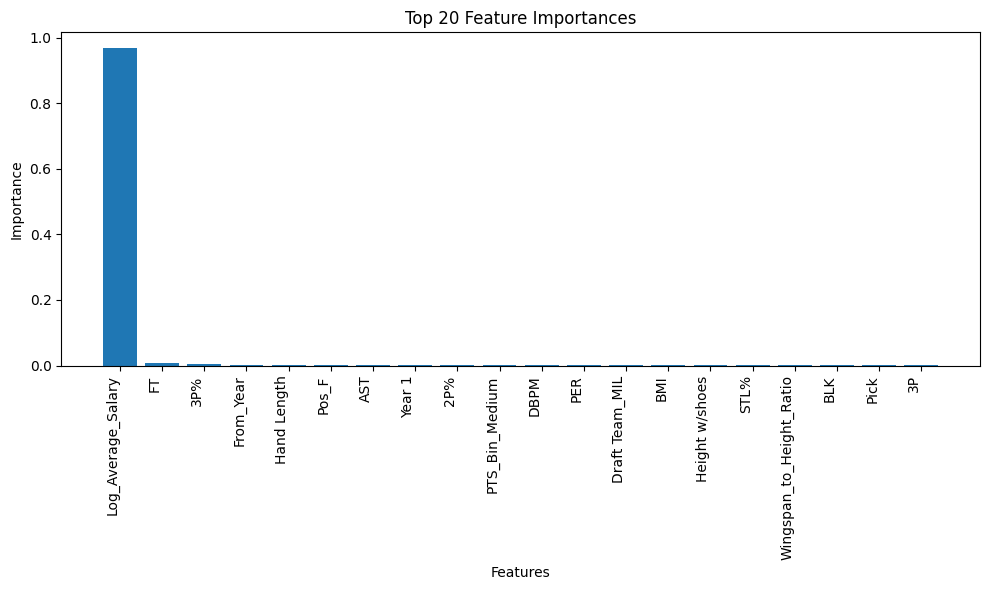

In [111]:
# Plot feature importance
plt.figure(figsize=(10, 6))
plt.bar(feature_importance_df['feature'][:20], feature_importance_df['importance'][:20])
plt.title('Top 20 Feature Importances')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.xticks(rotation=90, ha='right')
plt.tight_layout()
plt.show()


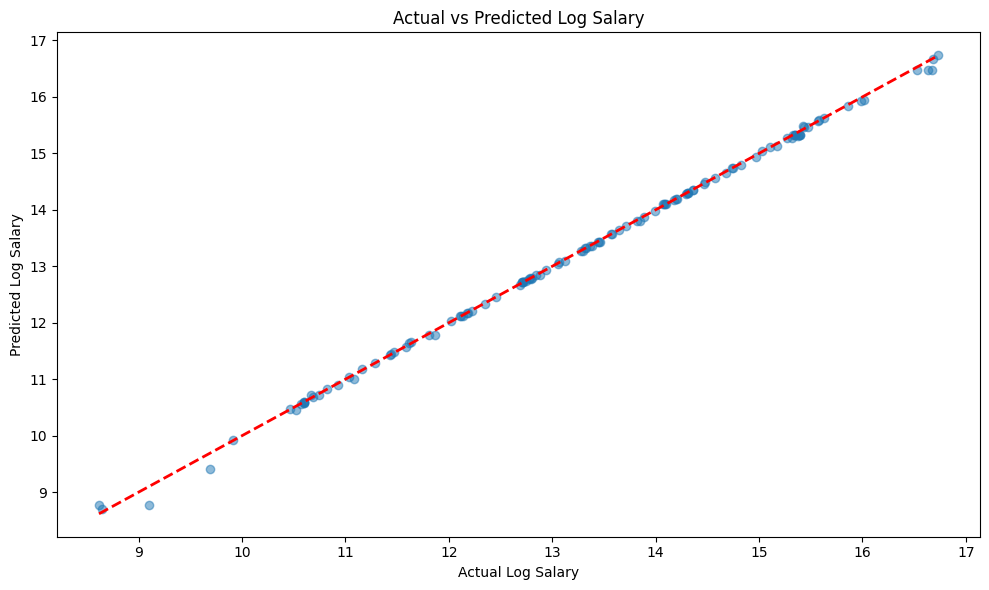

In [ ]:
# Scatter plot of predicted vs actual values
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
plt.xlabel('Actual Log Salary')
plt.ylabel('Predicted Log Salary')
plt.title('Actual vs Predicted Log Salary')
plt.tight_layout()
plt.show()


In [ ]:
# df_engineered.drop(columns=['Average Salary', 'Log_Salary'], axis=1, inplace=True)

In [112]:
# categorical and numerical columns
categorical_columns = ['College_Experience_Bin', 'Draft_Position_Bin', 'PTS_Bin', 'AST_Bin', 'TRB_Bin', 'PER_Bin', 'WS_Bin']
numerical_columns = [col for col in df_engineered.columns if col not in categorical_columns + ['Average Salary', 'Log_Salary', 'Year 1']]
# numerical_columns = [col for col in df_engineered.columns if col not in categorical_columns + ['Year 1', 'Log_Salary_Year1']]



X = df_engineered.drop(['Average Salary', 'Log_Salary', 'Year 1'], axis=1)
# X = df_engineered.drop(['Year 1'], axis=1)
y = df_engineered['Year 1']

# Apply log transformation to Year 1 salary
# https://www.geeksforgeeks.org/numpy-log1p-python/
y = np.log1p(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_columns),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
    ])

# Pipeline with preprocessor and XGBoost
xgb_model = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(random_state=42))
])

# 5. Define hyperparameters for tuning
param_grid = {
    'regressor__n_estimators': [100, 200, 300],
    'regressor__max_depth': [3, 4, 5],
    'regressor__learning_rate': [0.01, 0.1, 0.3],
    # https://stats.stackexchange.com/questions/576776/how-does-subsample-parameter-work-in-boosting-algorithms-like-xgboost-and-ligh
    'regressor__subsample': [0.8, 0.9, 1.0],
    'regressor__colsample_bytree': [0.8, 0.9, 1.0]
}

# Perform GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid,
                           cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Get best model
best_model = grid_search.best_estimator_

# Predict
y_pred = best_model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"Best parameters: {grid_search.best_params_}")
print(f"RMSE (log scale): {rmse}")
print(f"R-squared: {r2}")

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters: {'regressor__colsample_bytree': 0.8, 'regressor__learning_rate': 0.1, 'regressor__max_depth': 4, 'regressor__n_estimators': 100, 'regressor__subsample': 0.9}
RMSE (log scale): 0.3703740455196293
R-squared: 0.86120488308265


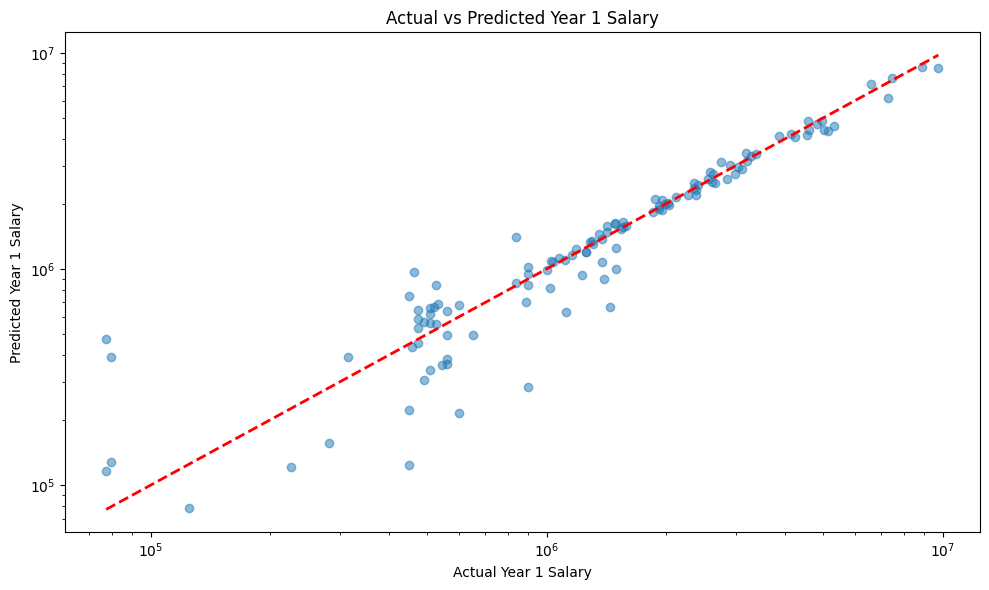

In [113]:
# Scatter plot of predicted vs actual values
plt.figure(figsize=(10, 6))
plt.scatter(np.expm1(y_test), np.expm1(y_pred), alpha=0.5)
plt.plot([np.expm1(y_test).min(), np.expm1(y_test).max()], [np.expm1(y_test).min(), np.expm1(y_test).max()], 'r--', lw=2)
plt.xlabel('Actual Year 1 Salary')
plt.ylabel('Predicted Year 1 Salary')
plt.title('Actual vs Predicted Year 1 Salary')
plt.xscale('log')
plt.yscale('log')
plt.tight_layout()
plt.show()



In [114]:
# Top 20 important features
print("\nTop 20 Important Features for Year 1 Salary Prediction:")
print(feature_importance_df.head(20))

# Calculate and print average percentage error
y_test_original = np.expm1(y_test)
y_pred_original = np.expm1(y_pred)
percentage_errors = np.abs((y_test_original - y_pred_original) / y_test_original) * 100
mean_percentage_error = np.mean(percentage_errors)
print(f"\nMean Absolute Percentage Error: {mean_percentage_error:.2f}%")


Top 20 Important Features for Year 1 Salary Prediction:
                      feature  importance
58         Log_Average_Salary    0.967638
13                         FT    0.007221
26                        3P%    0.005253
247                 From_Year    0.002580
48                Hand Length    0.001861
245                     Pos_F    0.001139
18                        AST    0.001005
252                    Year 1    0.000861
25                        2P%    0.000837
270            PTS_Bin_Medium    0.000832
37                       DBPM    0.000586
39                        PER    0.000516
87             Draft Team_MIL    0.000509
258                       BMI    0.000500
50             Height w/shoes    0.000460
44                       STL%    0.000458
259  Wingspan_to_Height_Ratio    0.000435
20                        BLK    0.000367
2                        Pick    0.000357
11                         3P    0.000322

Mean Absolute Percentage Error: 23.68%


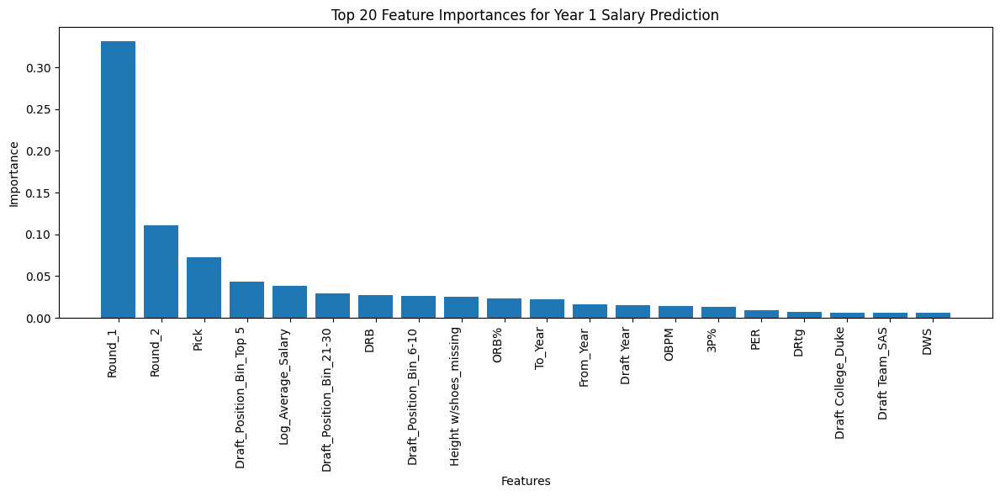

In [115]:
# Feature importance
feature_importance = best_model.named_steps['regressor'].feature_importances_
feature_names = (numerical_columns +
                 list(best_model.named_steps['preprocessor']
                      .named_transformers_['cat']
                      .get_feature_names_out(categorical_columns)))
feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': feature_importance})
feature_importance_df = feature_importance_df.sort_values('importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(12, 6))
plt.bar(feature_importance_df['feature'][:20], feature_importance_df['importance'][:20])
plt.title('Top 20 Feature Importances for Year 1 Salary Prediction')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.xticks(rotation=90, ha='right')
plt.tight_layout()
plt.show()


#### Testing Above Model



In [118]:
# Identify categorical and numerical columns
categorical_columns = ['College_Experience_Bin', 'Draft_Position_Bin', 'PTS_Bin', 'AST_Bin', 'TRB_Bin', 'PER_Bin', 'WS_Bin']
numerical_columns = [col for col in df_engineered.columns if col not in categorical_columns + ['Average Salary', 'Log_Salary', 'Year 1']]

# Prepare features and target
X = df_engineered.drop(['Average Salary', 'Log_Salary', 'Year 1'], axis=1)
y = df_engineered['Year 1']

# Apply log transformation to Year 1 salary
y = np.log1p(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_columns),
        ('cat', OneHotEncoder(drop='first',handle_unknown='ignore' ), categorical_columns)
    ])

# Pipeline with preprocessor and XGBoost
model = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(random_state=42))
])

# Fit the model
model.fit(X_train, y_train)

def predict_salary(model, player_features):
    # Check if player_features is a Series (single player) or DataFrame (multiple players)
    if isinstance(player_features, pd.Series):
        player_features = player_features.to_frame().T
    elif isinstance(player_features, pd.DataFrame):
        pass  # It's already a DataFrame, no need to convert
    else:
        raise ValueError("player_features must be a pandas Series or DataFrame")

    # Make prediction (model expects log-transformed salary)
    log_salary_pred = model.predict(player_features)
    # Convert back to original scale
    salary_pred = np.expm1(log_salary_pred)
    return salary_pred[0] if len(salary_pred) == 1 else salary_pred

import random
def random_predictions(X_test, y_test, model, n_players=5):
    # Randomly select n players
    random_indices = random.sample(range(len(X_test)), n_players)

    for i in random_indices:
        player_features = X_test.iloc[i]
        actual_salary = np.expm1(y_test.iloc[i])  # Convert back from log scale
        predicted_salary = predict_salary(model, player_features)

        print(f"\nPlayer {i+1}:")
        print(f"Actual Salary: ${actual_salary:,.2f}")
        print(f"Predicted Salary: ${predicted_salary:,.2f}")
        print(f"Percentage Error: {abs(predicted_salary - actual_salary) / actual_salary * 100:.2f}%")

        # Print some key features
        print("Key Features:")
        for feature in ['PTS', 'Draft_Position_Bin', 'College_Experience_Bin']:
            if feature in player_features.index:
                print(f"  {feature}: {player_features[feature]}")


# Use the function
random_predictions(X_test, y_test, model, n_players=5)

# To predict specific player
# specific_player = X_test.iloc[0]  # Replace 0 with the index of the player you're interested in
# predicted_salary = predict_salary(model, specific_player)
# print(f"Predicted Salary for specific player: ${predicted_salary:,.2f}")


Player 67:
Actual Salary: $1,563,120.00
Predicted Salary: $1,649,159.38
Percentage Error: 5.50%
Key Features:
  PTS: 836.0
  Draft_Position_Bin: 11-20
  College_Experience_Bin: Sophomore

Player 89:
Actual Salary: $898,310.00
Predicted Salary: $766,398.94
Percentage Error: 14.68%
Key Features:
  PTS: 2197.0
  Draft_Position_Bin: 31+
  College_Experience_Bin: Senior

Player 2:
Actual Salary: $2,020,200.00
Predicted Salary: $1,988,422.00
Percentage Error: 1.57%
Key Features:
  PTS: 483.0
  Draft_Position_Bin: 11-20
  College_Experience_Bin: Freshman

Player 31:
Actual Salary: $559,782.00
Predicted Salary: $706,012.81
Percentage Error: 26.12%
Key Features:
  PTS: 1866.0
  Draft_Position_Bin: 31+
  College_Experience_Bin: Senior

Player 12:
Actual Salary: $2,997,360.00
Predicted Salary: $2,764,447.50
Percentage Error: 7.77%
Key Features:
  PTS: 599.0
  Draft_Position_Bin: 6-10
  College_Experience_Bin: Freshman


#### Advanced NBA Rookie Salary Prediction Model with Interactions and Ensemble





In [82]:
def create_interaction_terms(X):
    # Create interaction terms between important numerical features
    important_features = ['PTS', 'AST', 'TRB', 'BLK', 'STL', 'FG%', '3P%', 'FT%']
    for i in range(len(important_features)):
        for j in range(i+1, len(important_features)):
            X[f'{important_features[i]}_{important_features[j]}'] = X[important_features[i]] * X[important_features[j]]
    return X

In [83]:
data['Points_per_Minute'] = data['PTS'] / data['MP']
data['Assists_per_Minute'] = data['AST'] / data['MP']
data['Rebounds_per_Minute'] = data['TRB'] / data['MP']
data['True_Shooting_Pct'] = data['PTS'] / (2 * (data['FGA'] + 0.44 * data['FTA']))
data['Years_in_College'] = data['Total_Years_Played']
data['BMI'] = data['Weight (lbs)'] / ((data['Height w/shoes'] / 39.37) ** 2)
data['Wingspan_to_Height_Ratio'] = data['Wingspan'] / data['Height w/shoes']
data['Overall_Shooting_Pct'] = (data['FG%'] + data['3P%'] + data['FT%']) / 3

In [84]:
df = create_interaction_terms(data)

In [86]:
# Prepare features and target
X = df.drop('Year 1', axis=1)
y = df['Year 1']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define preprocessing steps
numeric_features = X.select_dtypes(include=['int64', 'float64']).columns
categorical_features = X.select_dtypes(include=['object']).columns

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])


In [87]:
# Define models

# Define models
xgb_model = xgb.XGBRegressor(random_state=42)
rf_model = RandomForestRegressor(random_state=42)
nn_model = MLPRegressor(random_state=42)

In [88]:
# Create pipelines
xgb_pipeline = Pipeline([('preprocessor', preprocessor), ('regressor', xgb_model)])
rf_pipeline = Pipeline([('preprocessor', preprocessor), ('regressor', rf_model)])
nn_pipeline = Pipeline([('preprocessor', preprocessor), ('regressor', nn_model)])

# Train models
xgb_pipeline.fit(X_train, y_train)
rf_pipeline.fit(X_train, y_train)
nn_pipeline.fit(X_train, y_train)

# Make predictions
xgb_pred = xgb_pipeline.predict(X_test)
rf_pred = rf_pipeline.predict(X_test)
nn_pred = nn_pipeline.predict(X_test)

# Ensemble predictions (simple average)
ensemble_pred = (xgb_pred + rf_pred + nn_pred) / 3

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


In [89]:
# Evaluate models
def evaluate_model(y_true, y_pred, model_name):
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    print(f"{model_name} - RMSE: {rmse:.2f}, R2: {r2:.2f}")

evaluate_model(y_test, xgb_pred, "XGBoost")
evaluate_model(y_test, rf_pred, "Random Forest")
evaluate_model(y_test, nn_pred, "Neural Network")
evaluate_model(y_test, ensemble_pred, "Ensemble")

XGBoost - RMSE: 45250.96, R2: 1.00
Random Forest - RMSE: 41760.02, R2: 1.00
Neural Network - RMSE: 2644685.48, R2: -1.13
Ensemble - RMSE: 883585.53, R2: 0.76


In [90]:
# Feature importance (for XGBoost)
feature_importance = xgb_pipeline.named_steps['regressor'].feature_importances_
feature_names = xgb_pipeline.named_steps['preprocessor'].get_feature_names_out()
feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': feature_importance})
feature_importance_df = feature_importance_df.sort_values('importance', ascending=False)

print("\nTop 10 Important Features:")
print(feature_importance_df.head(10))

# Cross-validation
cv_scores = cross_val_score(xgb_pipeline, X, y, cv=5, scoring='neg_mean_squared_error')
cv_rmse = np.sqrt(-cv_scores)
print(f"\nCross-validation RMSE: {cv_rmse.mean():.2f} (+/- {cv_rmse.std() * 2:.2f})")


Top 10 Important Features:
                         feature  importance
260        num__Log_Salary_Year1    0.990348
287                 num__FG%_FT%    0.001410
288                 num__3P%_FT%    0.001038
29                     num__eFG%    0.001014
84           num__Draft Team_LAL    0.000947
93           num__Draft Team_ORL    0.000517
171  num__Draft College_NC State    0.000491
10                      num__2PA    0.000487
41                     num__DRB%    0.000427
73           num__Draft Team_BOS    0.000367

Cross-validation RMSE: 90160.65 (+/- 75137.27)
